# Unit 5 - Financial Planning Optional Challenge


In [23]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation
import json

%matplotlib inline

In [24]:
# Load .env enviroment variables
load_dotenv()

True

## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [25]:
# Set Alpaca API key and secret
# YOUR CODE HERE!
alpaca_api_key = os.getenv("APCA_API_KEY")
alpaca_secret_key = os.getenv("APCA_API_SECRET")
# Create the Alpaca API object
# YOUR CODE HERE!
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version= "v2")


In [26]:
print(f"Alpaca Key type: {type(alpaca_api_key)}")
print(f"Alpca Secret Key type: {type(alpaca_secret_key)}")

Alpaca Key type: <class 'str'>
Alpca Secret Key type: <class 'str'>




## Monte Carlo Simulation

In [27]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-14', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-14', tz='America/New_York').isoformat()

In [28]:
# Get 5 years' worth of historical data for SPY and AGG
# YOUR CODE HERE!
tickers = ["TSLA", "SPY"]

timeframe = "1D"

df_stock_data = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df
# Display sample data
df_stock_data.head()

SPY                                        TSLA  \
                             open    high       low   close    volume    open   
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  220.67   
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  216.43   
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  223.04   
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  226.50   
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395  227.52   

                                                               
                               high     low   close    volume  
2015-10-14 00:00:00-04:00  220.9900  215.43  216.89   2616982  
2015-10-15 00:00:00-04:00  221.7300  213.70  221.44   2382864  
2015-10-16 00:00:00-04:00  230.4805  222.87  227.00   3671426  
2015-10-19 00:00:00-04:00  231.1500  224.94  228.10   2052595  
2015-10-20 00:00:00-04:00  228.6000  202.00  213.03  13016428

In [29]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!
portfolio_forecast = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [.7,.3],
    num_simulation = 500,
    num_trading_days = 252*5
)



In [30]:
# Printing the simulation input data
# YOUR CODE HERE!
portfolio_forecast.portfolio_data.head()

SPY                                      \
                             open    high       low   close    volume   
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686   
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389   
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870   
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929   
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395   

                                          TSLA                            \
                          daily_return    open      high     low   close   
2015-10-14 00:00:00-04:00          NaN  220.67  220.9900  215.43  216.89   
2015-10-15 00:00:00-04:00     0.015356  216.43  221.7300  213.70  221.44   
2015-10-16 00:00:00-04:00     0.004003  223.04  230.4805  222.87  227.00   
2015-10-19 00:00:00-04:00     0.000935  226.50  231.1500  224.94  228.10   
2015-10-20 00:00:00-04:00    -0.001279  227.52  228.6000  202.00  213.03   

                                                  
                             volume daily_return  
2015-10-14 00:00:00-04:00   2616982          NaN  
2015-10-15 00:00:00-04:00   2382864     0.020978  
2015-10-16 00:00:00-04:00   3671426     0.025108  
2015-10-19 00:00:00-04:00   2052595     0.004846  
2015-10-20 00:00:00-04:00  13016428    -0.066068

In [31]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!
portfolio_forecast.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.007656,1.008896,0.980697,0.982979,1.027575,0.982295,0.990678,1.002150,0.976207,0.996114,...,0.974879,1.007995,0.993962,0.966583,1.016684,1.008677,0.978035,0.995077,0.997086,0.991541
2,1.005152,0.981902,0.992414,0.969841,0.994271,1.000010,0.973803,0.998807,0.972552,0.981722,...,0.960166,0.979351,0.998288,0.968912,1.014439,0.993545,0.977920,0.994583,0.989946,0.988579
3,1.023908,0.973618,0.998192,0.968028,1.023650,1.005290,0.970449,0.995780,0.974817,0.979191,...,0.955656,0.949709,0.993025,0.973535,1.015564,0.993082,0.959339,0.994903,0.968861,0.983695
4,0.996858,0.959163,1.003820,0.947368,1.018399,1.011499,0.996687,0.983395,0.952878,0.985001,...,0.956381,0.970387,0.977118,1.009269,1.026932,0.982945,0.942721,0.974990,0.978998,0.996882
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,3.178155,1.944186,4.166536,2.583336,1.919069,1.251988,5.076094,0.945570,2.451635,4.233117,...,5.603819,1.747625,2.291705,5.085903,1.543383,2.540307,2.206806,1.901467,1.813362,11.285191
1257,3.168306,1.954357,4.137458,2.568910,1.943711,1.236213,5.001939,0.948907,2.405181,4.250065,...,5.785598,1.763170,2.297374,5.048504,1.551518,2.541333,2.151267,1.933271,1.855805,11.533077
1258,3.192243,1.893832,4.131100,2.611775,1.921956,1.238403,4.951922,0.945088,2.430595,4.093848,...,5.853766,1.735388,2.312687,4.955932,1.542872,2.512432,2.203545,1.945522,1.866893,11.444805
1259,3.088617,1.861655,4.121937,2.573179,1.928393,1.234409,5.015123,0.944784,2.448826,4.126622,...,5.780554,1.776801,2.255746,4.951424,1.544903,2.465912,2.168844,1.966812,1.933415,11.467142


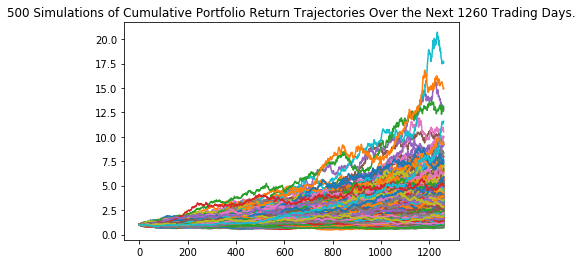

In [32]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot = portfolio_forecast.plot_simulation()

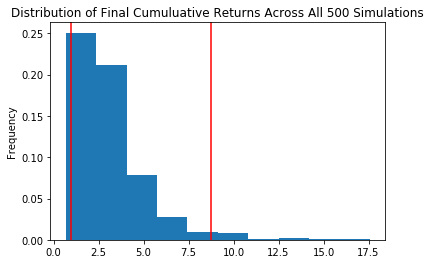

In [33]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
dist_plot = portfolio_forecast.plot_distribution()

### Retirement Analysis

In [34]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
stats_tbl = portfolio_forecast.summarize_cumulative_return()
# Print summary statistics
# YOUR CODE HERE!
print(stats_tbl)

count           500.000000
mean              3.169836
std               2.050939
min               0.674692
25%               1.837859
50%               2.617520
75%               3.839023
max              17.584021
95% CI Lower      0.980809
95% CI Upper      8.750245
Name: 1260, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [35]:
# Set initial investment
initial_investment = 100000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
# YOUR CODE HERE!
ci_lower = initial_investment * stats_tbl["95% CI Lower"]
ci_upper = initial_investment * stats_tbl["95% CI Upper"]
# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower:0.2f} and ${ci_upper:0.2f}")

There is a 95% chance that an initial investment of $100000 in the portfolio over the next 30 years will end within in the range of $98080.85 and $875024.48


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [36]:
# Set initial investment
initial_investment = 100000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
# YOUR CODE HERE!
ci_lower = initial_investment * stats_tbl["95% CI Lower"]
ci_upper = initial_investment * stats_tbl["95% CI Upper"]
# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower:0.2f} and ${ci_upper:0.2f}")

There is a 95% chance that an initial investment of $150000.0 in the portfolio over the next 30 years will end within in the range of $147121.28 and $1312536.73


### Ten Years Retirement Option

In [59]:
tickers_10 = ["AAPL", "TSLA", "SPY"]

timeframe = "1D"

df_tenyear_data = alpaca.get_barset(
    tickers_10,
    timeframe,
    start=start_date,
    end=end_date
).df
# Display sample data
df_tenyear_data.head()

AAPL                                       SPY  \
                             open    high     low   close    volume    open   
2015-10-14 00:00:00-04:00  111.29  111.52  109.56  110.21  39014295  200.18   
2015-10-15 00:00:00-04:00  110.93  112.10  110.49  111.85  33030464  200.08   
2015-10-16 00:00:00-04:00  111.78  112.00  110.53  111.02  33253074  202.83   
2015-10-19 00:00:00-04:00  110.80  111.75  110.11  111.73  25685587  202.50   
2015-10-20 00:00:00-04:00  111.34  114.17  110.82  113.80  43767752  202.85   

                                                                 TSLA  \
                             high       low   close    volume    open   
2015-10-14 00:00:00-04:00  200.87  198.9400  199.27  82856686  220.67   
2015-10-15 00:00:00-04:00  202.34  199.6400  202.33  96008389  216.43   
2015-10-16 00:00:00-04:00  203.29  201.9200  203.14  79323870  223.04   
2015-10-19 00:00:00-04:00  203.37  202.1300  203.33  61255929  226.50   
2015-10-20 00:00:00-04:00  203.84  202.5471  203.07  60081395  227.52   

                                                               
                               high     low   close    volume  
2015-10-14 00:00:00-04:00  220.9900  215.43  216.89   2616982  
2015-10-15 00:00:00-04:00  221.7300  213.70  221.44   2382864  
2015-10-16 00:00:00-04:00  230.4805  222.87  227.00   3671426  
2015-10-19 00:00:00-04:00  231.1500  224.94  228.10   2052595  
2015-10-20 00:00:00-04:00  228.6000  202.00  213.03  13016428

In [60]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!
ten_year_forecast = MCSimulation(
    portfolio_data = df_tenyear_data,
    weights = [.3,.5,.2],
    num_simulation = 500,
    num_trading_days = 252*10
)

In [61]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!
ten_year_forecast.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.990271,1.001064,1.011372,0.992760,1.035098,1.001327,0.988460,1.015594,0.986716,1.005234,...,1.016104,1.015976,1.015331,0.996201,1.015014,0.987173,1.010176,1.032434,0.989671,1.004772
2,0.997416,1.006132,0.999813,0.997520,1.017565,1.001775,0.988261,0.991626,0.971704,0.997219,...,1.024326,1.002277,1.019778,1.007519,1.009185,0.974339,1.029706,1.034898,1.000430,1.019902
3,1.000721,0.993476,0.994409,0.986167,1.035151,0.994362,0.996716,0.995754,0.984849,1.005554,...,1.012723,1.003151,1.019137,0.998724,1.005773,0.984110,1.032667,1.039431,1.007891,1.015932
4,1.012459,0.985366,0.996431,0.983986,1.045389,0.998245,0.991484,1.022417,0.980239,0.998856,...,0.996716,0.983386,0.993797,0.996353,0.993781,0.984298,1.035357,1.036435,1.033585,1.008461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,17.978594,5.513180,14.187999,3.945103,7.966100,22.244312,7.441526,7.522498,74.973312,12.165418,...,3.175592,5.091847,6.810025,5.306579,19.836872,12.917174,5.688371,19.225243,8.895314,4.521430
2517,18.398178,5.474309,14.143408,3.956065,8.069005,22.422335,7.519014,7.468142,74.454434,12.017725,...,3.139527,4.902479,6.801528,5.385928,19.324047,13.269484,5.825875,19.223494,8.814693,4.486416
2518,18.879163,5.463929,14.015933,4.044180,8.172771,22.683857,7.640345,7.520139,75.217600,11.957422,...,3.264594,4.967613,6.697954,5.417152,19.753072,13.223859,5.714099,19.028391,8.830401,4.523960
2519,19.094703,5.420129,14.233522,4.049890,8.212838,22.615564,7.732610,7.536604,75.190389,11.982993,...,3.257339,5.066077,6.675421,5.419428,19.945369,13.186604,5.744788,19.137980,8.717747,4.493411


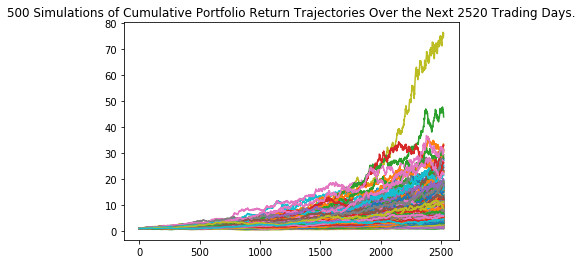

In [62]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot = ten_year_forecast.plot_simulation()

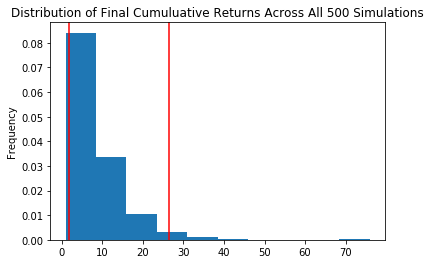

In [63]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
tenyear_dist_plot = ten_year_forecast.plot_distribution()

In [64]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
statistics_tbl = ten_year_forecast.summarize_cumulative_return()
# Print summary statistics
# YOUR CODE HERE!
print(statistics_tbl)

count           500.000000
mean              8.596020
std               6.716340
min               0.878377
25%               4.542020
50%               6.843862
75%              10.518925
max              76.020938
95% CI Lower      1.732315
95% CI Upper     26.369072
Name: 2520, dtype: float64


In [65]:
# Set initial investment
# YOUR CODE HERE!
initial_investment = 100000
# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!
ci_lower_ten = initial_investment * statistics_tbl["95% CI Lower"]
ci_upper_ten = initial_investment * statistics_tbl["95% CI Upper"]
# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten:0.2f} and ${ci_upper_ten:0.2f}")

There is a 95% chance that an initial investment of $100000 in the portfolio over the next 10 years will end within in the range of $173231.54 and $2636907.19
